### DCGAN with Cat-Face dataset

- 아래 자료들을 참고했습니다.
    - https://towardsdatascience.com/getting-started-with-gans-using-pytorch-78e7c22a14a5
    - https://github.com/shubham7169/Projects/blob/master/CAT-dcgan.ipynb

In [1]:
import os
from torch.utils.data import DataLoader
from torchvision.datasets import ImageFolder
import torchvision.transforms as transforms
import torch
import torch.nn as nn
import cv2
from tqdm.notebook import tqdm
import torch.nn.functional as F
from torchvision.utils import save_image
from torchvision.utils import make_grid
import matplotlib.pyplot as plt
%matplotlib inline

In [2]:
image_size = 64
batch_size = 128
stats = (0.5, 0.5, 0.5), (0.5, 0.5, 0.5) # mean, std

### Practice
- Load cat dataset

In [3]:
transform = transforms.Compose([
    transforms.Resize(image_size), # resize image to 64. - smaller edge will be 64 -> could be 64x64, 128x64, 128x64, ... 
    transforms.CenterCrop(image_size), # if the image is larger than 64x64, crop 64x64 from center. 
    transforms.ToTensor(), # PIL Image object to Tensor
    transforms.Normalize(*stats)]) # normalize the image to have *stats mean and std

train_ds = ImageFolder('./data/', transform=transform) # automatically apply transform on loading image - (Dataset)
train_dl = DataLoader(train_ds, batch_size, shuffle=True, num_workers=3, pin_memory=True)

In [4]:
def denorm(img_tensors):
    return img_tensors * stats[1][0] + stats[0][0] # make the values of result tensors have range of 0~1 : normal image.

In [5]:
def show_images(images, nmax=64):
    fig, ax = plt.subplots(figsize=(8, 8))
    ax.set_xticks([]); ax.set_yticks([])
    ax.imshow(make_grid(denorm(images.detach()[:nmax]), nrow=8).permute(1, 2, 0))

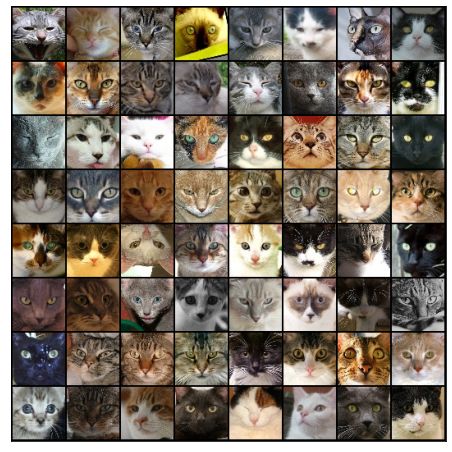

In [6]:
for images, _ in train_dl:
    show_images(images, 64) # dataset check
    break

In [7]:
def get_default_device():
    """Pick GPU if available, else CPU"""
    if torch.cuda.is_available():
        return torch.device('cuda')
    else:
        return torch.device('cpu')
    
def to_device(data, device):
    """Move tensor(s) to chosen device"""
    if isinstance(data, (list,tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

class DeviceDataLoader(): # data = data.to(device) 를 생략할 수 있기 위함
    """Wrap a dataloader to move data to a device"""
    def __init__(self, dl, device):
        self.dl = dl
        self.device = device
        
    def __iter__(self):
        """Yield a batch of data after moving it to device"""
        for b in self.dl: 
            yield to_device(b, self.device)

    def __len__(self):
        """Number of batches"""
        return len(self.dl)

In [8]:
device = get_default_device()
print(device)

cuda


In [9]:
train_dl = DeviceDataLoader(train_dl, device) # dataloader to default device

### Define Discriminator

In [10]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        
        self.model = nn.Sequential(
        
        nn.Conv2d(3, 64, kernel_size=4, stride=2, padding=1, bias=False),
        nn.BatchNorm2d(64),
        nn.LeakyReLU(0.2, inplace=True),
        
        
        nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1, bias=False),
        nn.BatchNorm2d(128),
        nn.LeakyReLU(0.2, inplace=True),
        
        
        nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1, bias=False),
        nn.BatchNorm2d(256),
        nn.LeakyReLU(0.2, inplace=True),
        
        
        nn.Conv2d(256, 512, kernel_size=4, stride=2, padding=1, bias=False),
        nn.BatchNorm2d(512),
        nn.LeakyReLU(0.2, inplace=True),
        
        
        nn.Conv2d(512, 1, kernel_size=4, stride=1, padding=0, bias=False),
        
        nn.Flatten(),
        nn.Sigmoid()) 
        # By applying Sigmoid, the result will have value in range of 0~1. We interpret the resulting value to be "probability"
        
    def forward(self, x):
        x = self.model(x)
        return x    

discriminator = Discriminator()
discriminator = to_device(discriminator, device)

### Define Generator

In [11]:
latent_size = 128

class Generator(nn.Module):
    def __init__(self, latent_size):
        super(Generator, self).__init__()
        self.latent_size = latent_size
        self.model = nn.Sequential(
            
        nn.ConvTranspose2d(latent_size, 512, kernel_size=4, stride=1, padding=0, bias=False),
        nn.BatchNorm2d(512),
        nn.ReLU(True),
        
        nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1, bias=False),
        nn.BatchNorm2d(256),
        nn.ReLU(True),
        
        nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1, bias=False),
        nn.BatchNorm2d(128),
        nn.ReLU(True),
        
        nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1, bias=False),
        nn.BatchNorm2d(64),
        nn.ReLU(True),
        
        nn.ConvTranspose2d(64, 3, kernel_size=4, stride=2, padding=1, bias=False),
        nn.Tanh())
        # constantly upsamples random vector (latent) to generate image.
        # Tanh to limit output value range.
    def forward(self, x):
        x = self.model(x)
        return x  
    
generator = Generator(latent_size)

### Initial Generator Results

torch.Size([128, 3, 64, 64])


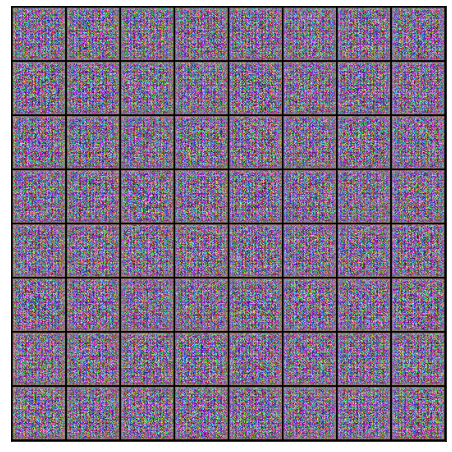

In [12]:
xb = torch.randn(batch_size, latent_size, 1, 1) # random latent tensors
fake_images = generator(xb)
print(fake_images.shape)
show_images(fake_images)
# Generator is not trained. 
# It outputs random noise.

In [13]:
generator = to_device(generator, device)

### Practice
- Implement discriminator loss


$$ \mathcal{L}_{D} = \mathbb{E}_{z \sim N(0,I), x \sim p_{data}(x)}[log(D(x)) + log(1 - D(G(z)))] $$
$$  $$
$$ or $$
$$ \mathcal{L}_{D} = \frac{1}{N}\sum_{i}^{N}[log(D(x_{i})) + log(1 - D(G(z_{i})))] $$

In [14]:
def train_discriminator(real_images, opt_d):
    # Clear discriminator gradients
    opt_d.zero_grad()

    # Pass real images through discriminator
    real_preds = discriminator(real_images)
    real_targets = torch.ones(real_images.size(0), 1, device=device)
    real_loss = F.binary_cross_entropy(real_preds, real_targets)
    real_score = torch.mean(real_preds).item()
    
    # Generate fake images
    latent = torch.randn(batch_size, latent_size, 1, 1, device=device)
    fake_images = generator(latent)

    # Pass fake images through discriminator
    fake_targets = torch.zeros(fake_images.size(0), 1, device=device)
    fake_preds = discriminator(fake_images)
    fake_loss = F.binary_cross_entropy(fake_preds, fake_targets)
    fake_score = torch.mean(fake_preds).item()

    # Update discriminator weights
    loss = real_loss + fake_loss
    loss.backward()
    opt_d.step()
    return loss.item(), real_score, fake_score

### Practice
- Implement generator loss

$$ \mathcal{L}_{G} = \mathbb{E}_{z \sim N(0,I)}[log(1 - D(G(z)))] $$
$$  $$
$$ or $$
$$ \mathcal{L}_{G} = \frac{1}{N} \sum_{i}^{N}[log(1 - D(G(z_{i})))] $$

In [15]:
def train_generator(opt_g):
    # Clear generator gradients
    opt_g.zero_grad()
    
    # Generate fake images
    latent = torch.randn(batch_size, latent_size, 1, 1, device=device)
    fake_images = generator(latent)
    
    # Try to fool the discriminator
    preds = discriminator(fake_images)
    targets = torch.ones(batch_size, 1, device=device)
    loss = F.binary_cross_entropy(preds, targets)
    
    # Update generator weights
    loss.backward()
    opt_g.step()
    
    return loss.item()

In [16]:
sample_dir = 'generated'
os.makedirs(sample_dir, exist_ok=True)

In [17]:
def save_samples(index, latent_tensors, show=True):
    fake_images = generator(latent_tensors)
    fake_fname = 'generated-images-{0:0=4d}.png'.format(index)
    save_image(denorm(fake_images), os.path.join(sample_dir, fake_fname), nrow=8)
    print('Saving', fake_fname)
    if show:
        fig, ax = plt.subplots(figsize=(8, 8))
        ax.set_xticks([]); ax.set_yticks([])
        ax.imshow(make_grid(denorm(fake_images.cpu().detach()), nrow=8).permute(1, 2, 0))

In [18]:
fixed_latent = torch.randn(64, latent_size, 1, 1, device=device) # constant latent vector -> to see learning process

Saving generated-images-0000.png


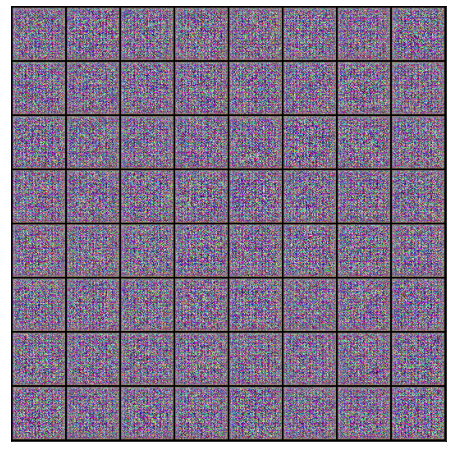

In [19]:
save_samples(0, fixed_latent)

In [20]:
from IPython.display import Image

In [21]:
def fit(epochs, lr, start_idx=1):
    torch.cuda.empty_cache()
    
    # Losses & scores
    losses_g = []
    losses_d = []
    real_scores = []
    fake_scores = []
    
    # Create optimizers
    opt_d = torch.optim.Adam(discriminator.parameters(), lr=lr, betas=(0.5, 0.999))
    opt_g = torch.optim.Adam(generator.parameters(), lr=lr, betas=(0.5, 0.999))
    
    for epoch in range(epochs):
        generator.train()
        discriminator.train()
        for real_images, _ in tqdm(train_dl):
            # Train discriminator
            loss_d, real_score, fake_score = train_discriminator(real_images, opt_d)
            # Train generator
            loss_g = train_generator(opt_g)
            
        # Record losses & scores
        losses_g.append(loss_g)
        losses_d.append(loss_d)
        real_scores.append(real_score)
        fake_scores.append(fake_score)
        
        # Log losses & scores (last batch)
        print("Epoch [{}/{}], loss_g: {:.4f}, loss_d: {:.4f}, real_score: {:.4f}, fake_score: {:.4f}".format(
            epoch+1, epochs, loss_g, loss_d, real_score, fake_score))
    
        # Save generated images
        with torch.no_grad():
            generator.eval()
            save_samples(epoch+start_idx, fixed_latent, show=True)
            fake_images = generator(fixed_latent)
            plt.clf()
            fig, ax = plt.subplots(figsize=(8, 8))
            ax.set_xticks([]); ax.set_yticks([])
            ax.imshow(make_grid(denorm(fake_images.cpu().detach()), nrow=8).permute(1, 2, 0))
            plt.show()
        
    return losses_g, losses_d, real_scores, fake_scores

In [22]:
lr = 0.0002
epochs = 60

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [1/60], loss_g: 3.9689, loss_d: 0.2632, real_score: 0.8820, fake_score: 0.1243
Saving generated-images-0001.png


<Figure size 576x576 with 0 Axes>

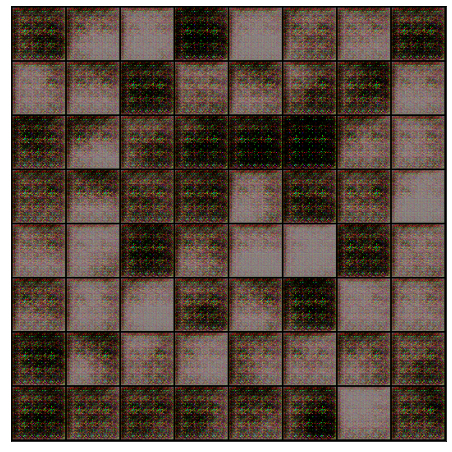

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [2/60], loss_g: 0.6745, loss_d: 1.6314, real_score: 0.3530, fake_score: 0.1930
Saving generated-images-0002.png


<Figure size 576x576 with 0 Axes>

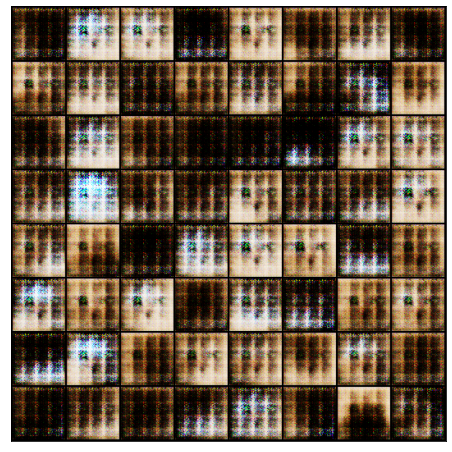

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [3/60], loss_g: 1.2735, loss_d: 1.3677, real_score: 0.3549, fake_score: 0.1463
Saving generated-images-0003.png


<Figure size 576x576 with 0 Axes>

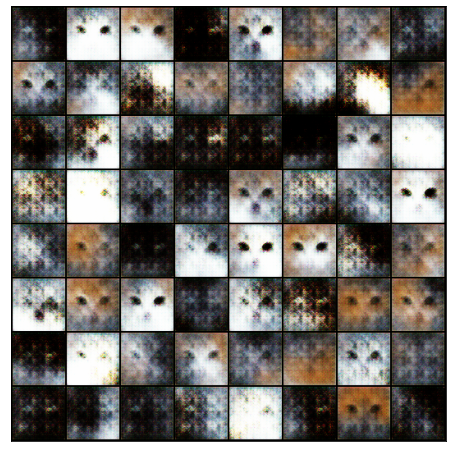

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [4/60], loss_g: 1.5295, loss_d: 0.6285, real_score: 0.5777, fake_score: 0.0590
Saving generated-images-0004.png


<Figure size 576x576 with 0 Axes>

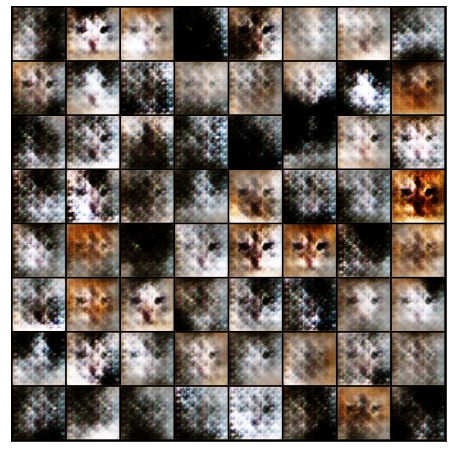

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [5/60], loss_g: 2.9223, loss_d: 0.8033, real_score: 0.7323, fake_score: 0.3191
Saving generated-images-0005.png


<Figure size 576x576 with 0 Axes>

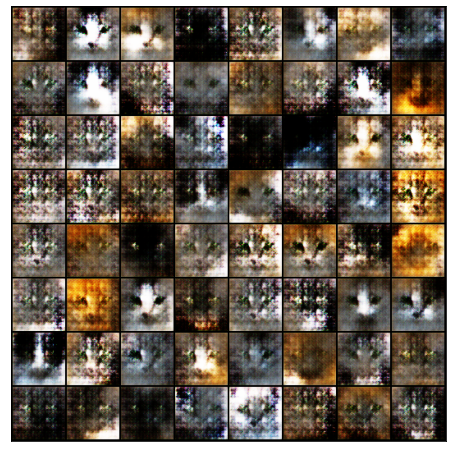

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [6/60], loss_g: 4.7901, loss_d: 0.4607, real_score: 0.9391, fake_score: 0.2895
Saving generated-images-0006.png


<Figure size 576x576 with 0 Axes>

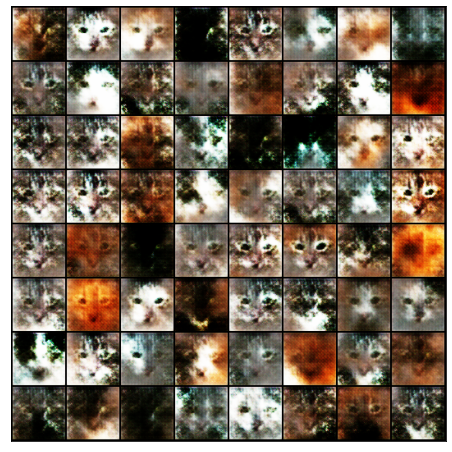

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [7/60], loss_g: 4.8700, loss_d: 0.2457, real_score: 0.9781, fake_score: 0.1919
Saving generated-images-0007.png


<Figure size 576x576 with 0 Axes>

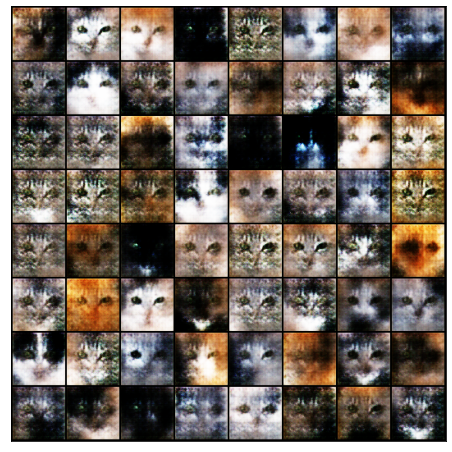

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [8/60], loss_g: 4.4232, loss_d: 0.4206, real_score: 0.6973, fake_score: 0.0440
Saving generated-images-0008.png


<Figure size 576x576 with 0 Axes>

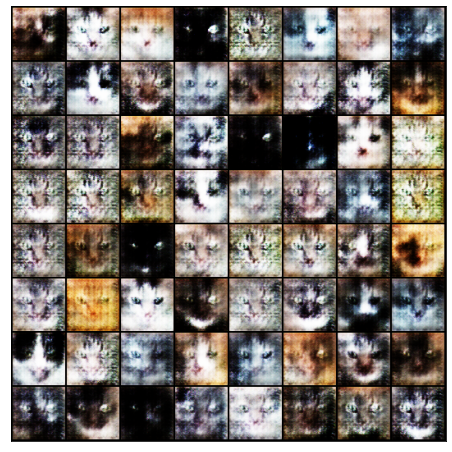

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [9/60], loss_g: 4.8569, loss_d: 0.2955, real_score: 0.9417, fake_score: 0.1987
Saving generated-images-0009.png


<Figure size 576x576 with 0 Axes>

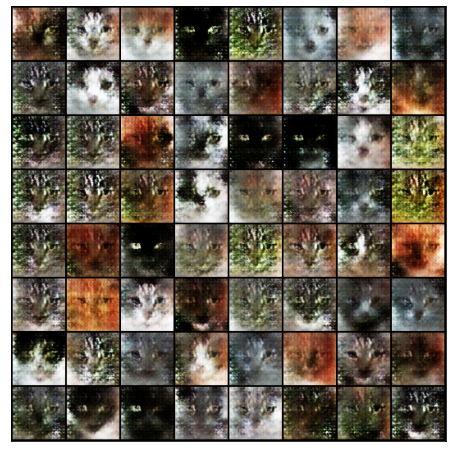

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [10/60], loss_g: 4.7317, loss_d: 0.1901, real_score: 0.9710, fake_score: 0.1339
Saving generated-images-0010.png


<Figure size 576x576 with 0 Axes>

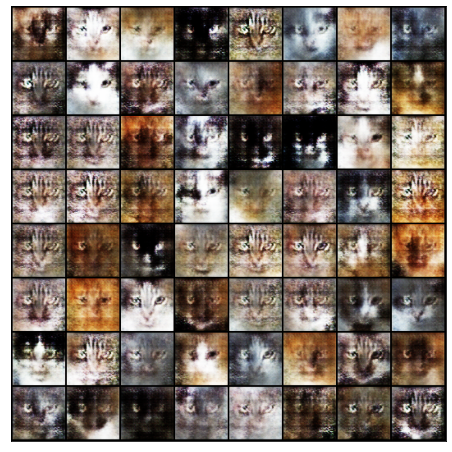

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [11/60], loss_g: 1.3209, loss_d: 2.0705, real_score: 0.1445, fake_score: 0.0114
Saving generated-images-0011.png


<Figure size 576x576 with 0 Axes>

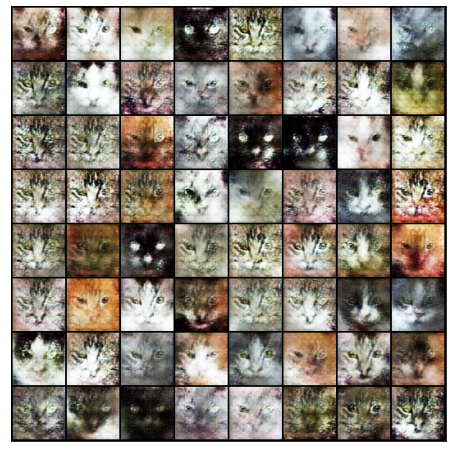

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [12/60], loss_g: 0.2856, loss_d: 1.8123, real_score: 0.2697, fake_score: 0.2595
Saving generated-images-0012.png


<Figure size 576x576 with 0 Axes>

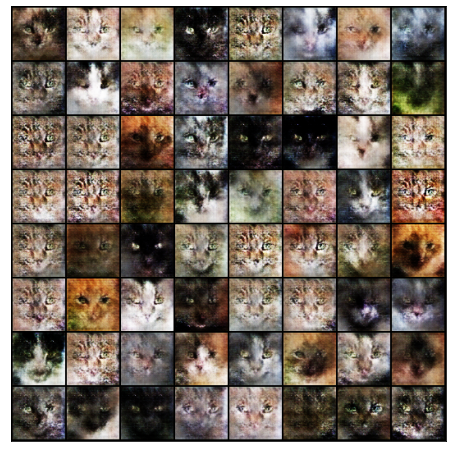

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [13/60], loss_g: 4.1110, loss_d: 3.3304, real_score: 0.0395, fake_score: 0.0004
Saving generated-images-0013.png


<Figure size 576x576 with 0 Axes>

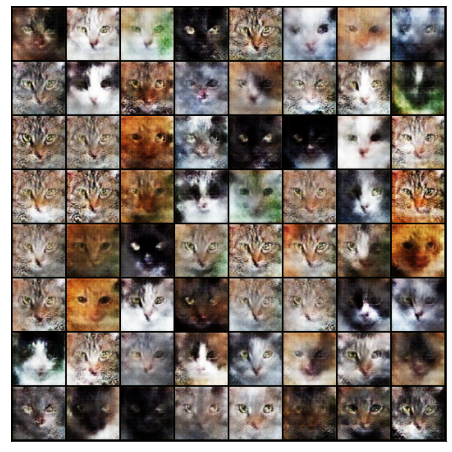

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [14/60], loss_g: 3.3141, loss_d: 0.8000, real_score: 0.6137, fake_score: 0.2278
Saving generated-images-0014.png


<Figure size 576x576 with 0 Axes>

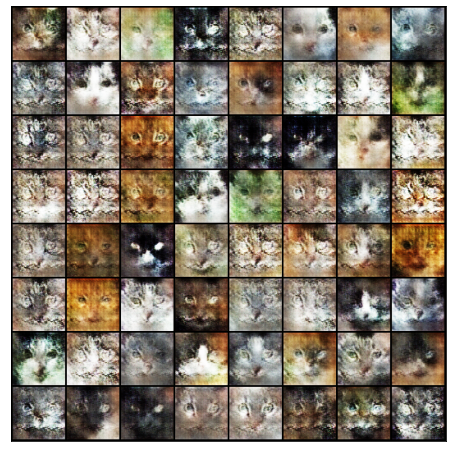

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [15/60], loss_g: 3.7845, loss_d: 0.1268, real_score: 0.9821, fake_score: 0.1008
Saving generated-images-0015.png


<Figure size 576x576 with 0 Axes>

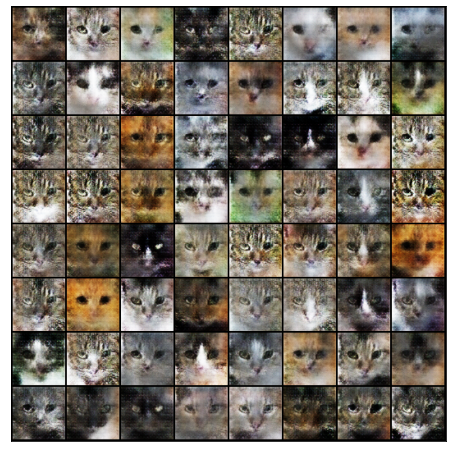

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [16/60], loss_g: 2.9968, loss_d: 2.7629, real_score: 0.1455, fake_score: 0.5252
Saving generated-images-0016.png


<Figure size 576x576 with 0 Axes>

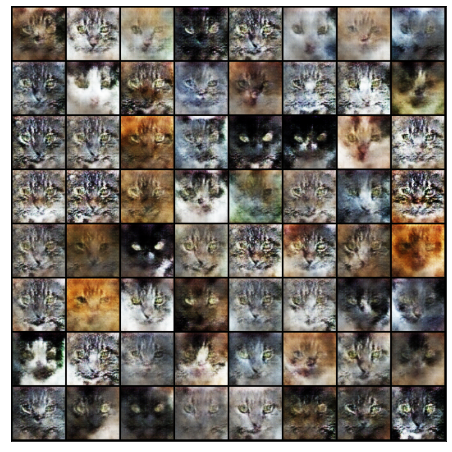

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [17/60], loss_g: 1.7348, loss_d: 0.4720, real_score: 0.6744, fake_score: 0.0370
Saving generated-images-0017.png


<Figure size 576x576 with 0 Axes>

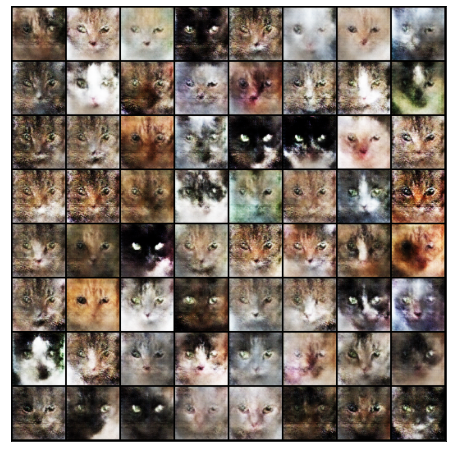

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [18/60], loss_g: 5.6933, loss_d: 4.3145, real_score: 0.0241, fake_score: 0.0010
Saving generated-images-0018.png


<Figure size 576x576 with 0 Axes>

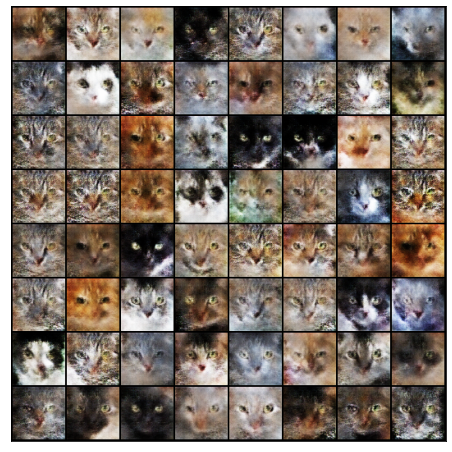

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [19/60], loss_g: 1.7549, loss_d: 0.8677, real_score: 0.5279, fake_score: 0.1591
Saving generated-images-0019.png


<Figure size 576x576 with 0 Axes>

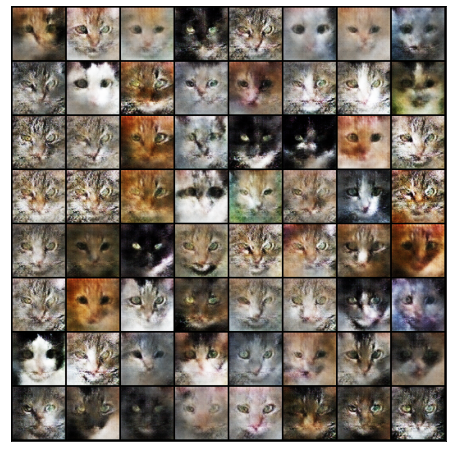

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [20/60], loss_g: 4.0861, loss_d: 0.0873, real_score: 0.9938, fake_score: 0.0753
Saving generated-images-0020.png


<Figure size 576x576 with 0 Axes>

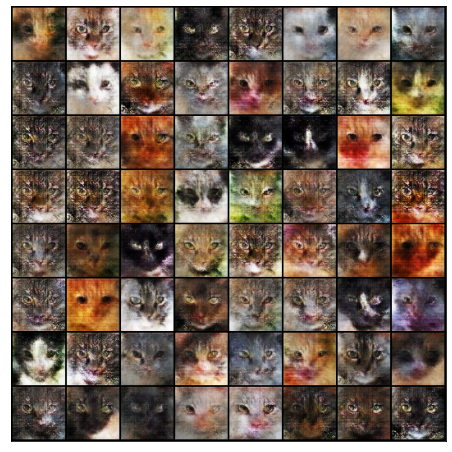

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [21/60], loss_g: 1.8858, loss_d: 0.6069, real_score: 0.6400, fake_score: 0.0577
Saving generated-images-0021.png


<Figure size 576x576 with 0 Axes>

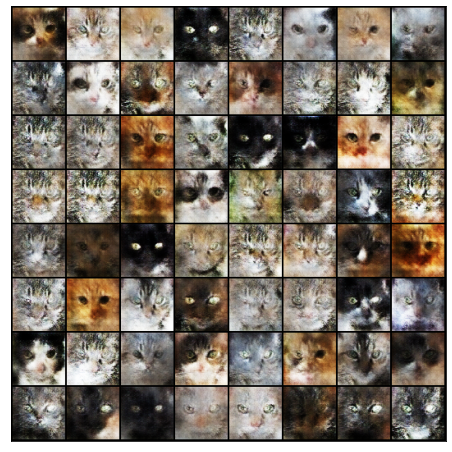

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [22/60], loss_g: 5.3962, loss_d: 0.9990, real_score: 0.8945, fake_score: 0.5145
Saving generated-images-0022.png


<Figure size 576x576 with 0 Axes>

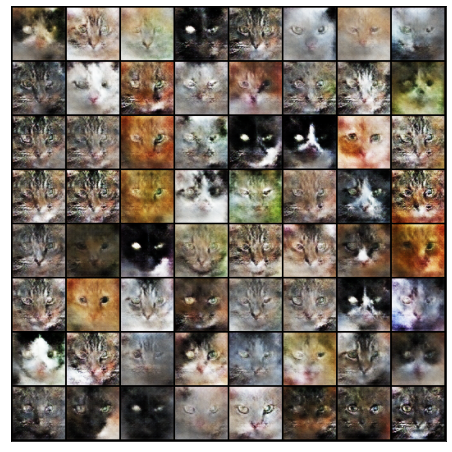

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [23/60], loss_g: 4.1578, loss_d: 0.0215, real_score: 0.9985, fake_score: 0.0194
Saving generated-images-0023.png


<Figure size 576x576 with 0 Axes>

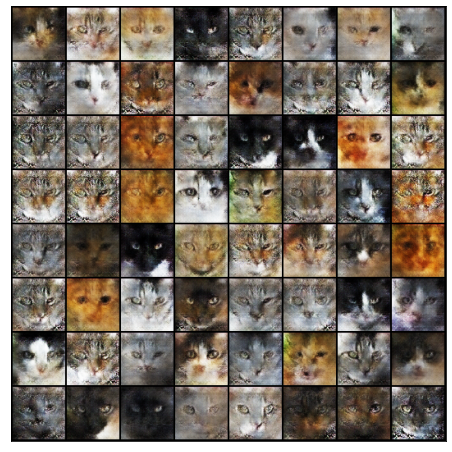

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [24/60], loss_g: 2.5002, loss_d: 1.7126, real_score: 0.1872, fake_score: 0.0035
Saving generated-images-0024.png


<Figure size 576x576 with 0 Axes>

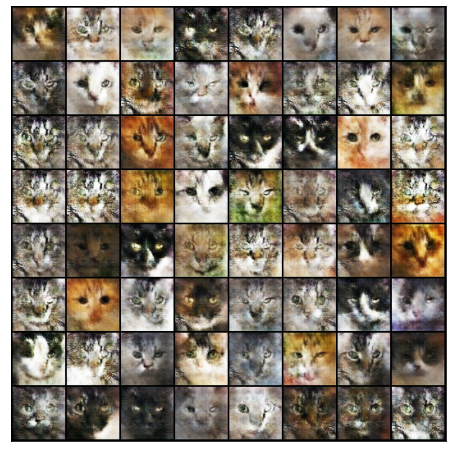

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [25/60], loss_g: 2.3669, loss_d: 0.3687, real_score: 0.7496, fake_score: 0.0683
Saving generated-images-0025.png


<Figure size 576x576 with 0 Axes>

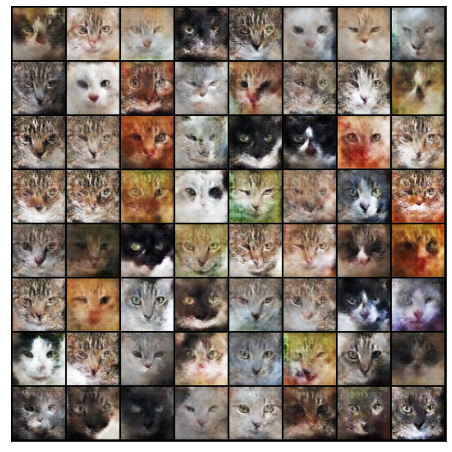

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [26/60], loss_g: 3.5890, loss_d: 0.2395, real_score: 0.8335, fake_score: 0.0381
Saving generated-images-0026.png


<Figure size 576x576 with 0 Axes>

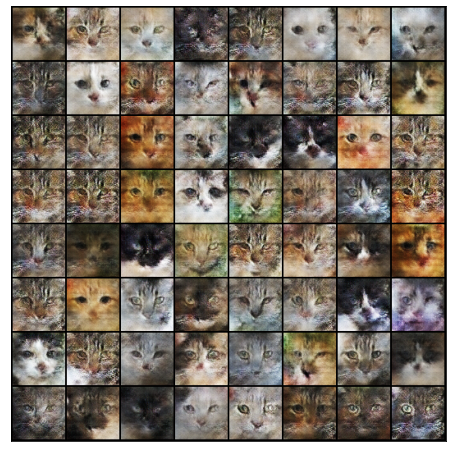

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [27/60], loss_g: 3.2668, loss_d: 0.5778, real_score: 0.9906, fake_score: 0.3800
Saving generated-images-0027.png


<Figure size 576x576 with 0 Axes>

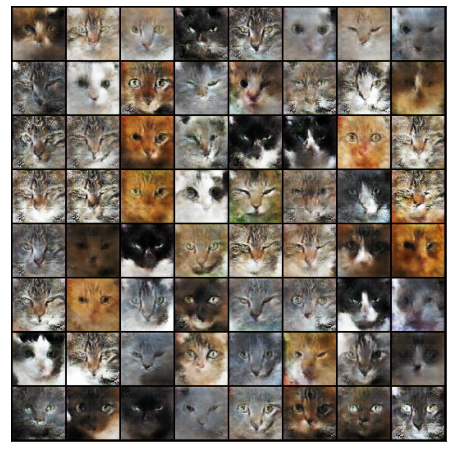

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [28/60], loss_g: 2.7550, loss_d: 0.3547, real_score: 0.7793, fake_score: 0.0841
Saving generated-images-0028.png


<Figure size 576x576 with 0 Axes>

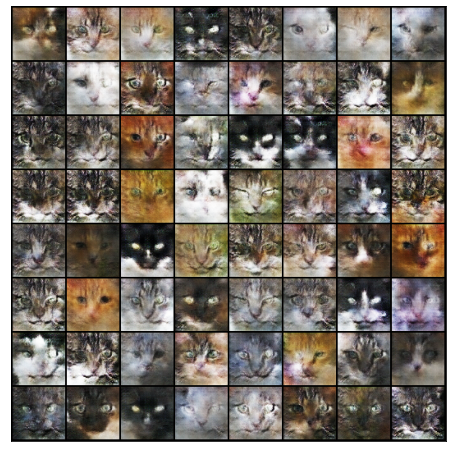

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [29/60], loss_g: 3.8065, loss_d: 0.9097, real_score: 0.6009, fake_score: 0.2893
Saving generated-images-0029.png


<Figure size 576x576 with 0 Axes>

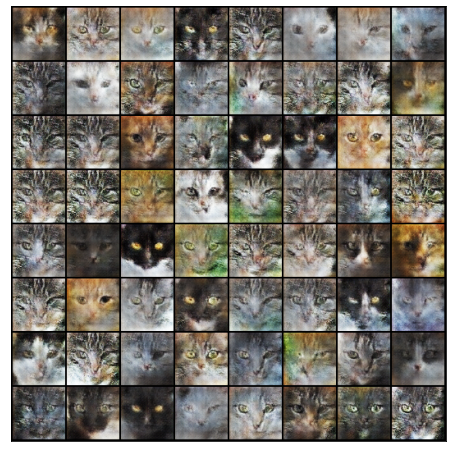

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [30/60], loss_g: 7.4845, loss_d: 0.6350, real_score: 0.9805, fake_score: 0.4192
Saving generated-images-0030.png


<Figure size 576x576 with 0 Axes>

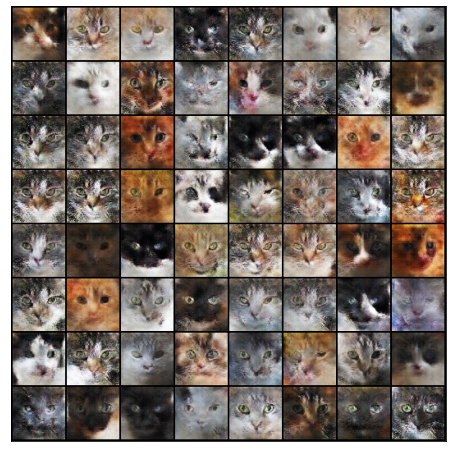

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [31/60], loss_g: 8.2507, loss_d: 0.5800, real_score: 0.9997, fake_score: 0.3877
Saving generated-images-0031.png


<Figure size 576x576 with 0 Axes>

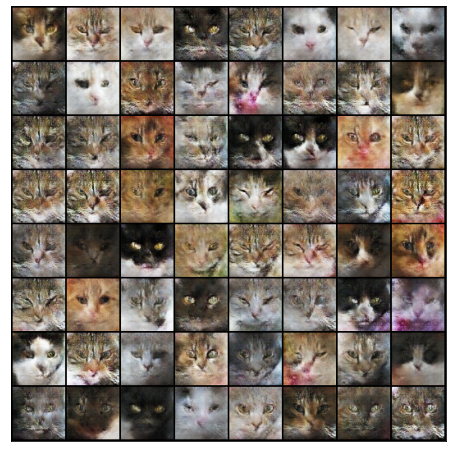

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [32/60], loss_g: 0.2439, loss_d: 1.3714, real_score: 0.3172, fake_score: 0.1383
Saving generated-images-0032.png


<Figure size 576x576 with 0 Axes>

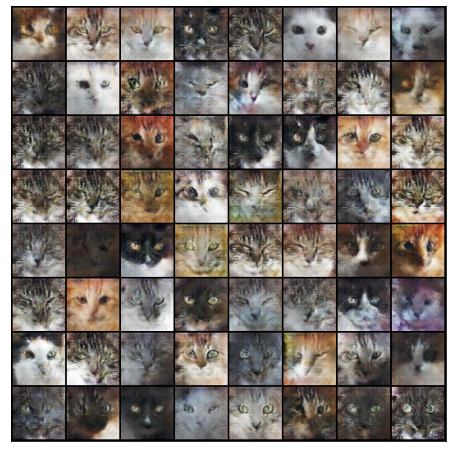

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [33/60], loss_g: 1.6917, loss_d: 2.6109, real_score: 0.1068, fake_score: 0.0039
Saving generated-images-0033.png


<Figure size 576x576 with 0 Axes>

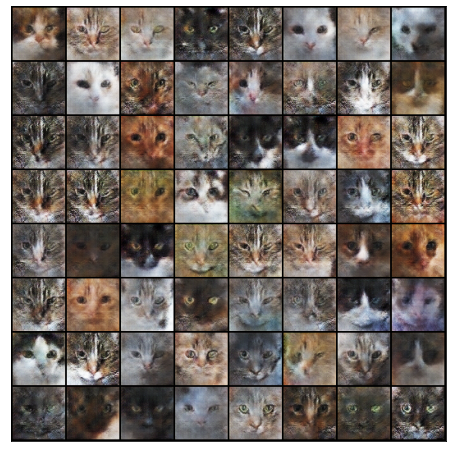

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [34/60], loss_g: 0.7183, loss_d: 3.3309, real_score: 0.1389, fake_score: 0.0127
Saving generated-images-0034.png


<Figure size 576x576 with 0 Axes>

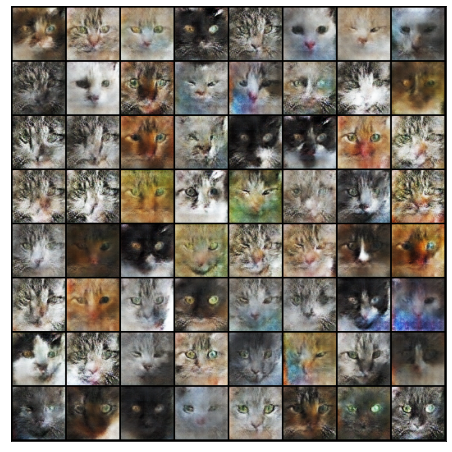

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [35/60], loss_g: 2.6788, loss_d: 5.5108, real_score: 0.0044, fake_score: 0.0012
Saving generated-images-0035.png


<Figure size 576x576 with 0 Axes>

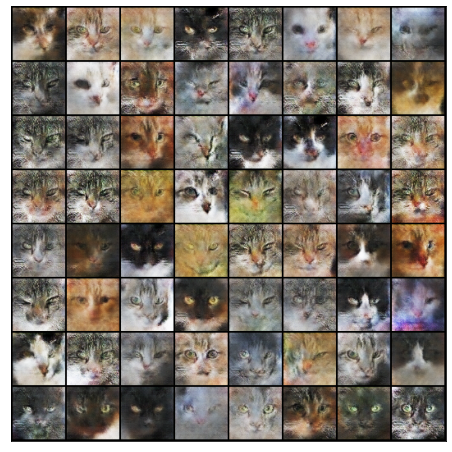

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [36/60], loss_g: 3.8904, loss_d: 0.1894, real_score: 0.8477, fake_score: 0.0167
Saving generated-images-0036.png


<Figure size 576x576 with 0 Axes>

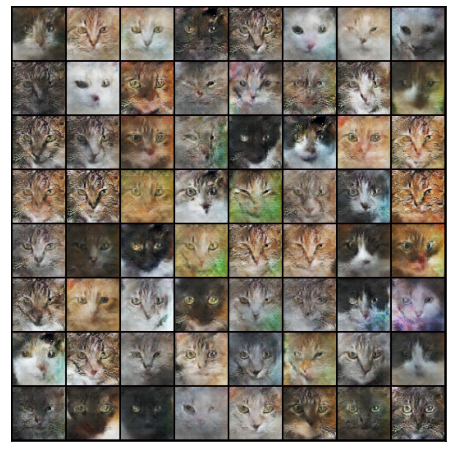

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [37/60], loss_g: 11.6876, loss_d: 1.9863, real_score: 0.9526, fake_score: 0.7964
Saving generated-images-0037.png


<Figure size 576x576 with 0 Axes>

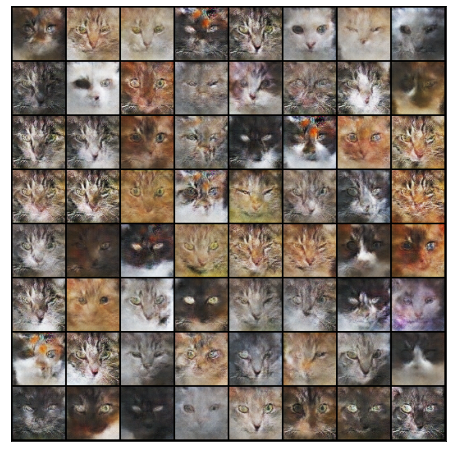

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [38/60], loss_g: 2.2287, loss_d: 2.0399, real_score: 0.1343, fake_score: 0.0013
Saving generated-images-0038.png


<Figure size 576x576 with 0 Axes>

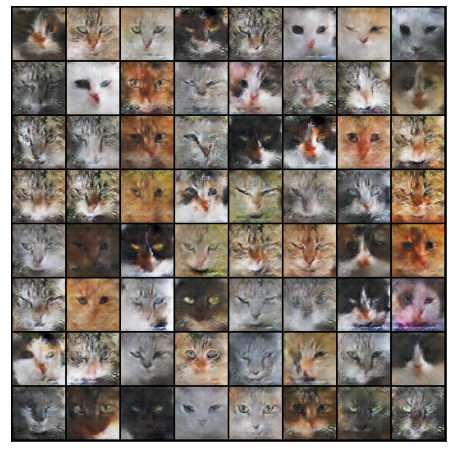

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [39/60], loss_g: 1.9706, loss_d: 1.4392, real_score: 0.3710, fake_score: 0.0240
Saving generated-images-0039.png


<Figure size 576x576 with 0 Axes>

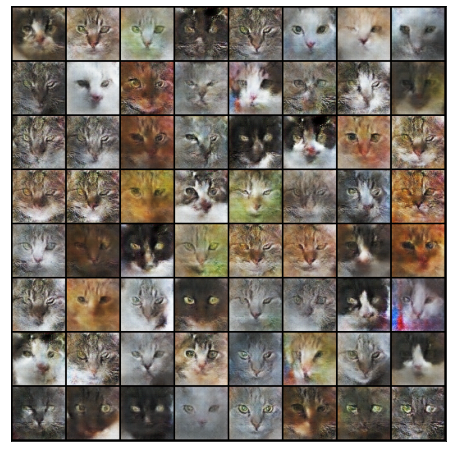

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [40/60], loss_g: 5.6743, loss_d: 0.3165, real_score: 0.9240, fake_score: 0.1949
Saving generated-images-0040.png


<Figure size 576x576 with 0 Axes>

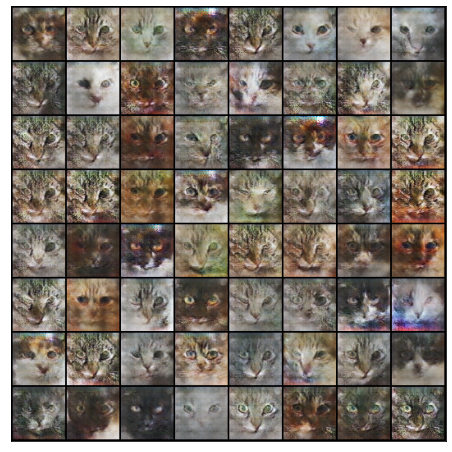

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [41/60], loss_g: 4.8316, loss_d: 0.1308, real_score: 0.9591, fake_score: 0.0795
Saving generated-images-0041.png


<Figure size 576x576 with 0 Axes>

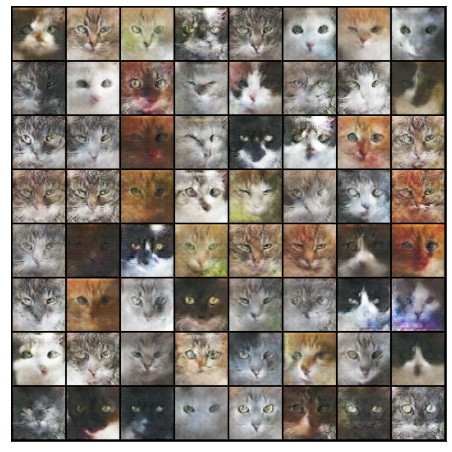

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [42/60], loss_g: 5.4744, loss_d: 0.2015, real_score: 0.9863, fake_score: 0.1576
Saving generated-images-0042.png


<Figure size 576x576 with 0 Axes>

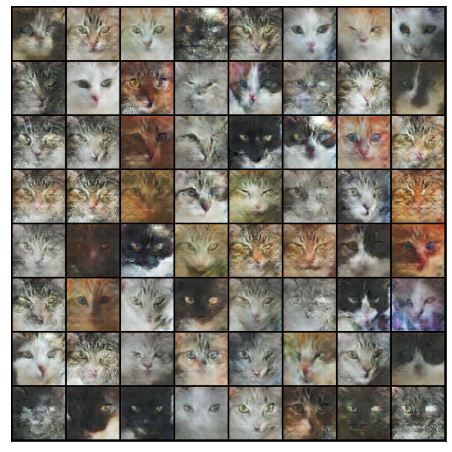

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [43/60], loss_g: 1.1665, loss_d: 0.6377, real_score: 0.6563, fake_score: 0.1732
Saving generated-images-0043.png


<Figure size 576x576 with 0 Axes>

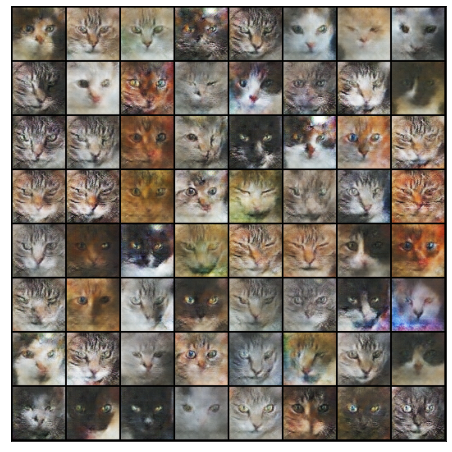

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [44/60], loss_g: 8.4255, loss_d: 0.7551, real_score: 0.9805, fake_score: 0.4544
Saving generated-images-0044.png


<Figure size 576x576 with 0 Axes>

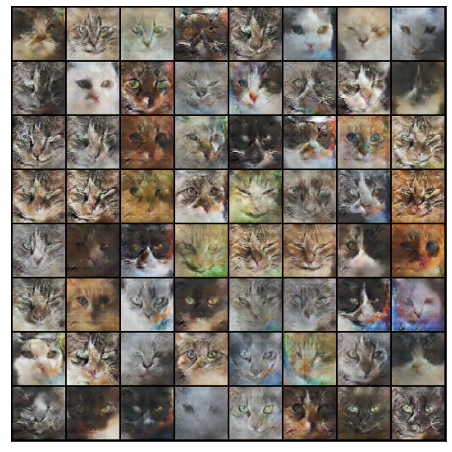

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [45/60], loss_g: 4.4810, loss_d: 0.2498, real_score: 0.9200, fake_score: 0.1402
Saving generated-images-0045.png


<Figure size 576x576 with 0 Axes>

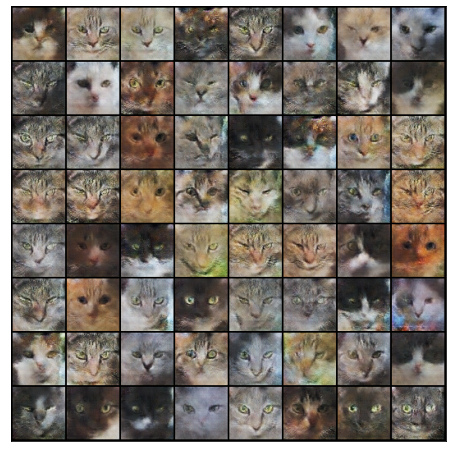

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [46/60], loss_g: 2.4359, loss_d: 0.7594, real_score: 0.5138, fake_score: 0.0451
Saving generated-images-0046.png


<Figure size 576x576 with 0 Axes>

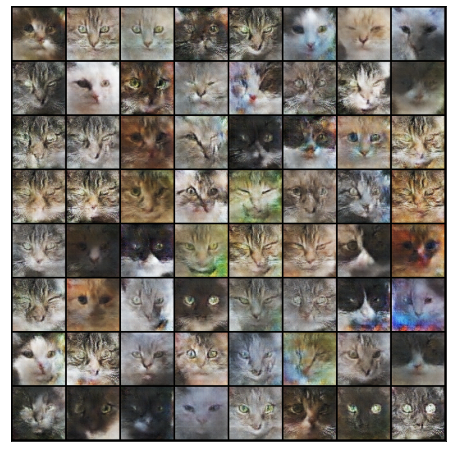

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [47/60], loss_g: 6.3027, loss_d: 0.4511, real_score: 0.9937, fake_score: 0.3200
Saving generated-images-0047.png


<Figure size 576x576 with 0 Axes>

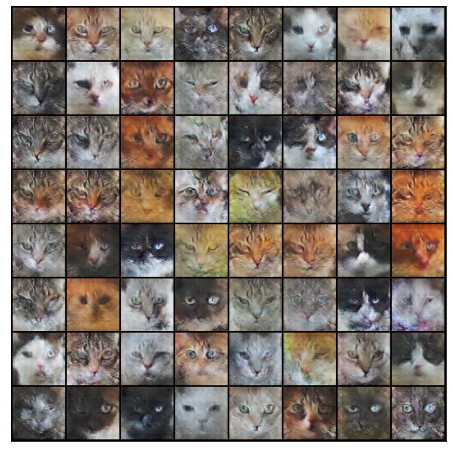

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [48/60], loss_g: 4.9028, loss_d: 0.3443, real_score: 0.8821, fake_score: 0.1851
Saving generated-images-0048.png


<Figure size 576x576 with 0 Axes>

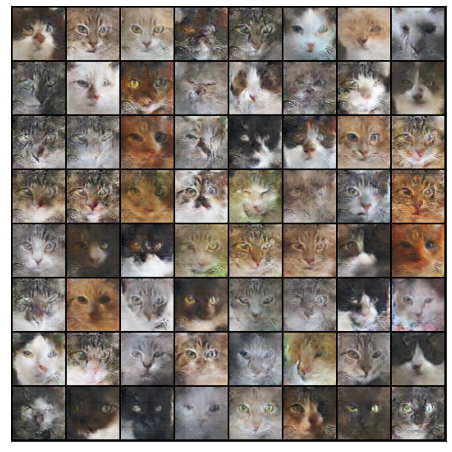

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [49/60], loss_g: 11.7689, loss_d: 1.5784, real_score: 0.9602, fake_score: 0.7270
Saving generated-images-0049.png


<Figure size 576x576 with 0 Axes>

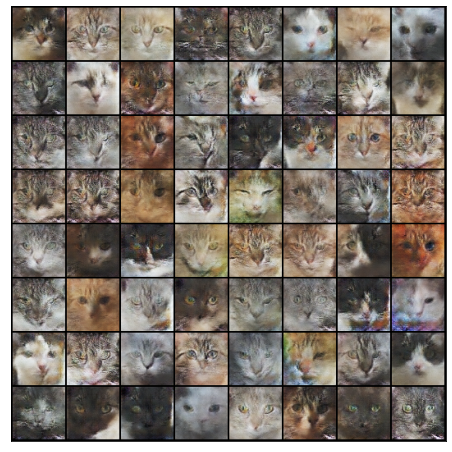

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [50/60], loss_g: 5.6753, loss_d: 0.0163, real_score: 0.9904, fake_score: 0.0065
Saving generated-images-0050.png


<Figure size 576x576 with 0 Axes>

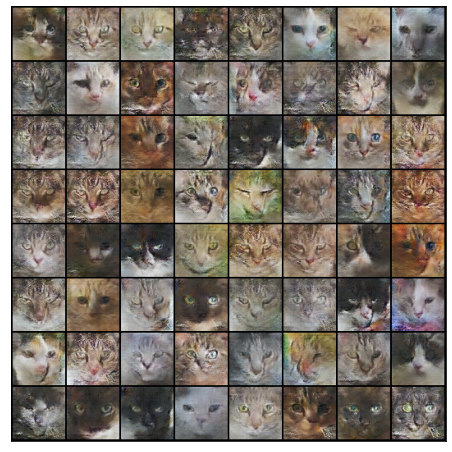

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [51/60], loss_g: 3.1817, loss_d: 0.2266, real_score: 0.8612, fake_score: 0.0683
Saving generated-images-0051.png


<Figure size 576x576 with 0 Axes>

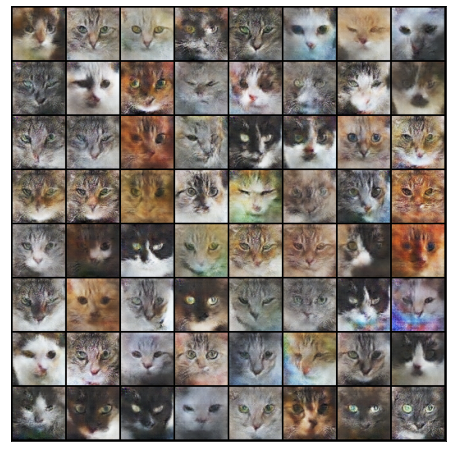

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [52/60], loss_g: 4.3642, loss_d: 0.3896, real_score: 0.9760, fake_score: 0.2717
Saving generated-images-0052.png


<Figure size 576x576 with 0 Axes>

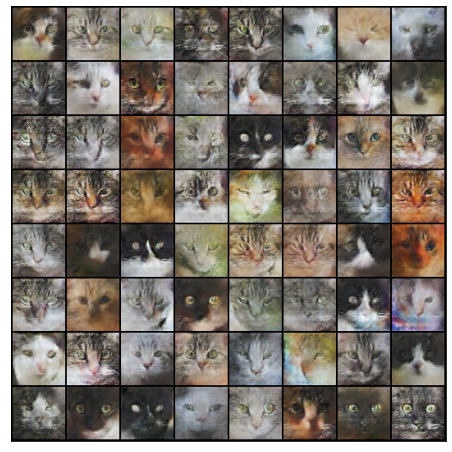

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [53/60], loss_g: 3.3643, loss_d: 0.2460, real_score: 0.8282, fake_score: 0.0171
Saving generated-images-0053.png


<Figure size 576x576 with 0 Axes>

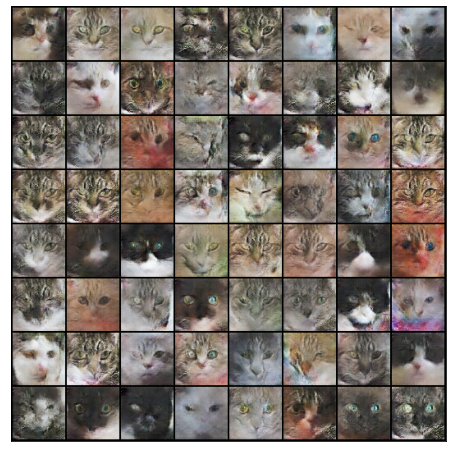

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [54/60], loss_g: 2.0216, loss_d: 1.1999, real_score: 0.4108, fake_score: 0.2108
Saving generated-images-0054.png


<Figure size 576x576 with 0 Axes>

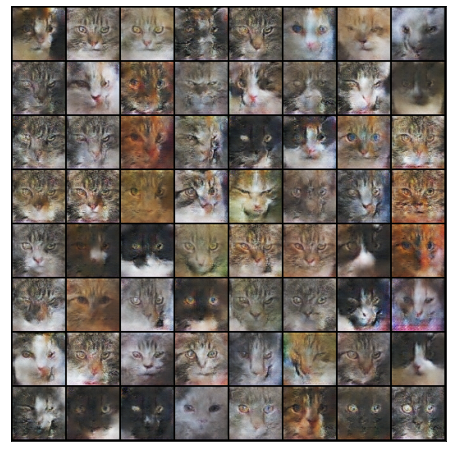

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [55/60], loss_g: 3.3968, loss_d: 0.0810, real_score: 0.9415, fake_score: 0.0180
Saving generated-images-0055.png


<Figure size 576x576 with 0 Axes>

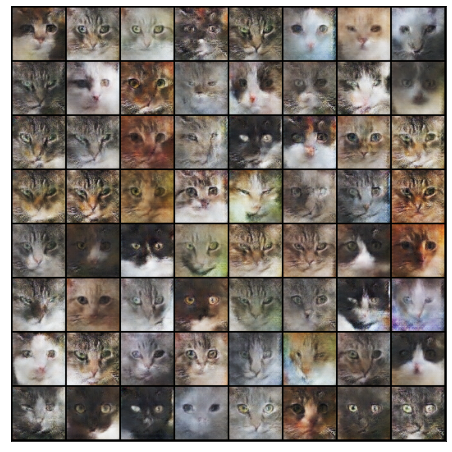

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [56/60], loss_g: 3.7465, loss_d: 1.2554, real_score: 0.3332, fake_score: 0.0041
Saving generated-images-0056.png


<Figure size 576x576 with 0 Axes>

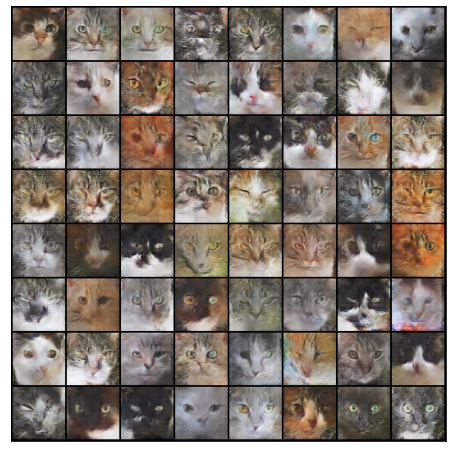

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [57/60], loss_g: 3.1014, loss_d: 0.2975, real_score: 0.7923, fake_score: 0.0508
Saving generated-images-0057.png


<Figure size 576x576 with 0 Axes>

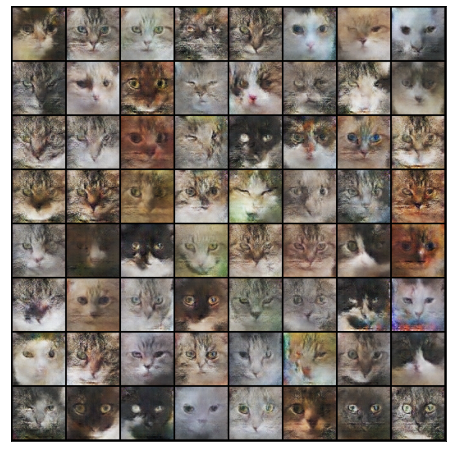

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [58/60], loss_g: 2.3197, loss_d: 0.9423, real_score: 0.5318, fake_score: 0.2253
Saving generated-images-0058.png


<Figure size 576x576 with 0 Axes>

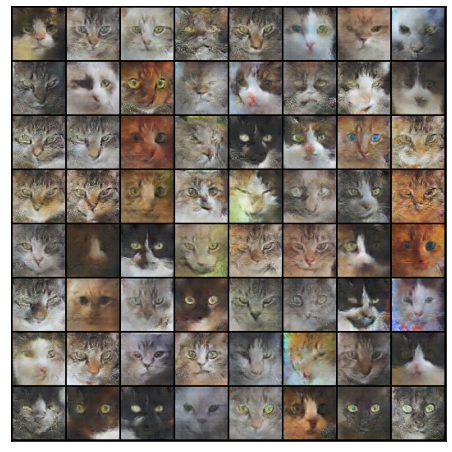

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [59/60], loss_g: 1.8756, loss_d: 1.7772, real_score: 0.3203, fake_score: 0.0611
Saving generated-images-0059.png


<Figure size 576x576 with 0 Axes>

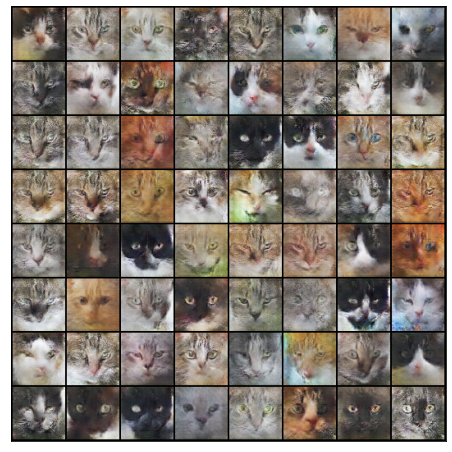

  0%|          | 0/124 [00:00<?, ?it/s]

Epoch [60/60], loss_g: 5.5217, loss_d: 0.0480, real_score: 0.9584, fake_score: 0.0052
Saving generated-images-0060.png


<Figure size 576x576 with 0 Axes>

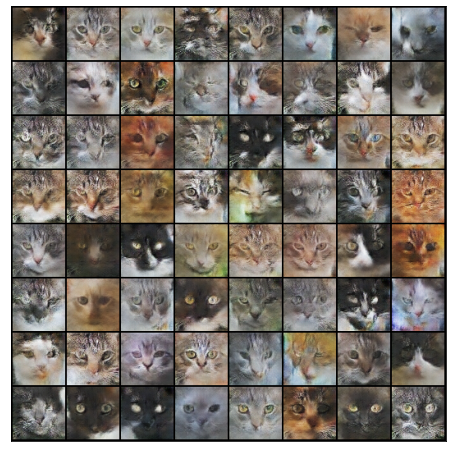

In [23]:
history = fit(epochs, lr)

In [24]:
losses_g, losses_d, real_scores, fake_scores = history

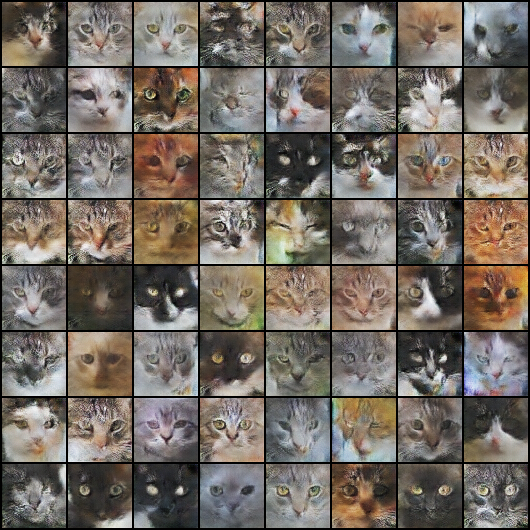

In [25]:
Image('./generated/generated-images-0060.png')


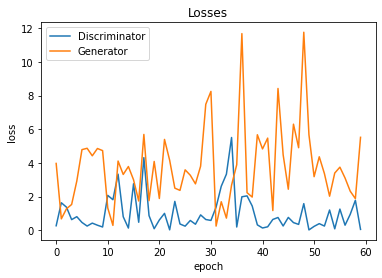

In [26]:
plt.plot(losses_d, '-')
plt.plot(losses_g, '-')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend(['Discriminator', 'Generator'])
plt.title('Losses');

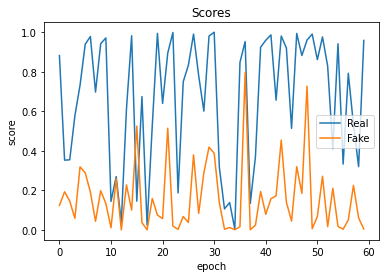

In [27]:
plt.plot(real_scores, '-')
plt.plot(fake_scores, '-')
plt.xlabel('epoch')
plt.ylabel('score')
plt.legend(['Real', 'Fake'])
plt.title('Scores');

In [29]:
torch.save(generator.state_dict(), 'generator.pkl')
torch.save(discriminator.state_dict(), 'discriminator.pkl')